In [6]:
from time import time
import matplotlib.pyplot as plt
import numpy as np
import scipy as sp
import scanpy as sc
from bbknn import bbknn
import scanorama
import pandas as pd
from matplotlib import rcParams
from harmony import harmonize
from sklearn.utils import shuffle

import warnings

warnings.filterwarnings('ignore')

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.set_figure_params(dpi=100)

scanpy==1.6.0 anndata==0.7.4 umap==0.3.10 numpy==1.17.2 scipy==1.5.2 pandas==1.1.0 scikit-learn==0.21.3 statsmodels==0.10.1 python-igraph==0.7.1 louvain==0.6.1 leidenalg==0.7.0


# Meis2 Ilustration


cluster all gaba from all times together and color by subclass to show Meis expressed Meis2 and Pax6 and is in early times only then remove it from this object and split this object into each time and go crazy

In [32]:

paths_obj = ['P8_gaba0828.h5ad', 'P14_gaba0828.h5ad', 'P17_gaba0828.h5ad',
             'P21_gaba0828.h5ad', 'P28_gaba0828.h5ad', 'P38_gaba0828.h5ad']

gaba_objs = []
ages = []
for i in paths_obj:
    gaba_objs.append(sc.read_h5ad(path + i))
    ages.append(i.split('_')[0])

In [33]:
gaba_all = gaba_objs[0].concatenate(gaba_objs[1:], batch_categories=ages)

In [36]:
Subclass = []
for i in range(gaba_all.shape[0]):
    Subclass.append(gaba_all.obs['cluster_name'][i].split('_')[0])
    
gaba_all.obs['Subclass'] = pd.Categorical(Subclass)
gaba_all.obs['Age'] = gaba_all.obs['batch']

In [38]:
gaba_all

AnnData object with n_obs × n_vars = 15013 × 30869
    obs: 'batch', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'Doublet', 'Doublet Score', 'cluster', 'Class_broad', 'cluster_name', 'sample', 'Subclass', 'Age'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable-P14', 'means-P14', 'dispersions-P14', 'dispersions_norm-P14', 'mean-P14', 'std-P14', 'highly_variable-P17', 'means-P17', 'dispersions-P17', 'dispersions_norm-P17', 'mean-P17', 'std-P17', 'highly_variable-P21', 'means-P21', 'dispersions-P21', 'dispersions_norm-P21', 'mean-P21', 'std-P21', 'highly_variable-P28', 'means-P28', 'dispersions-P28', 'dispersions_norm-P28', 'mean-P28', 'std-P28', 'highly_variable-P38', 'means-P38', 'dispersions-P38', 'dispersions_norm-P38', 'mean-P38', 'std-P38', 'highly_variable-P8', 'means-P8', 'dispersions-P8', 'dispersions_norm-P8', 'mean-P8', 'std-P8'
    obsm: 'X_pca', 'X_umap'

In [63]:
gaba_all.X = gaba_all.raw.X

In [42]:
for i in ['highly_variable-P14', 'means-P14', 'dispersions-P14', 'dispersions_norm-P14', 'mean-P14', 'std-P14', 'highly_variable-P17', 'means-P17', 'dispersions-P17', 'dispersions_norm-P17', 'mean-P17', 'std-P17', 'highly_variable-P21', 'means-P21', 'dispersions-P21', 'dispersions_norm-P21', 'mean-P21', 'std-P21', 'highly_variable-P28', 'means-P28', 'dispersions-P28', 'dispersions_norm-P28', 'mean-P28', 'std-P28', 'highly_variable-P38', 'means-P38', 'dispersions-P38', 'dispersions_norm-P38', 'mean-P38', 'std-P38', 'highly_variable-P8', 'means-P8', 'dispersions-P8', 'dispersions_norm-P8', 'mean-P8', 'std-P8']:
    del gaba_all.var[i]
    
del gaba_all.obsm

In [43]:
gaba_all

AnnData object with n_obs × n_vars = 15013 × 30869
    obs: 'batch', 'n_genes', 'percent_mito', 'n_counts', 'leiden', 'Doublet', 'Doublet Score', 'cluster', 'Class_broad', 'cluster_name', 'sample', 'Subclass', 'Age'
    var: 'gene_ids', 'feature_types', 'n_cells'

In [64]:
sc.pp.highly_variable_genes(gaba_all, min_mean=0.0125, max_mean=3, min_disp=0.5) #HVGs
sc.pp.scale(gaba_all, max_value=10) #scale
sc.tl.pca(gaba_all, svd_solver='arpack') #run PCA

Z = harmonize(gaba_all.obsm['X_pca'], gaba_all.obs, batch_key = 'Age')
gaba_all.obsm['X_harmony'] = Z

sc.pp.neighbors(gaba_all, n_neighbors=25, use_rep='X_harmony')
sc.tl.leiden(gaba_all)
sc.tl.umap(gaba_all)

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    on highly variable genes
    with n_comps=50


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    finished (0:00:05)
	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
	Completed 4 / 10 iteration(s).
	Completed 5 / 10 iteration(s).
	Completed 6 / 10 iteration(s).
	Completed 7 / 10 iteration(s).
	Completed 8 / 10 iteration(s).
Reach convergence after 8 iteration(s).
computing neighbors


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../../../opt/anaconda3/lib/python3.7/site-packages/umap/rp_tree.py", line 135:
@numba.njit(fastmath=True, nogil=True, parallel=True)
def euclidean_random_projection_split(data, indices, rng_state):
^

  self.func_ir.loc))
/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../../../opt/ana

    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:06)
running Leiden clustering
    finished: found 22 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:04)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:12)


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


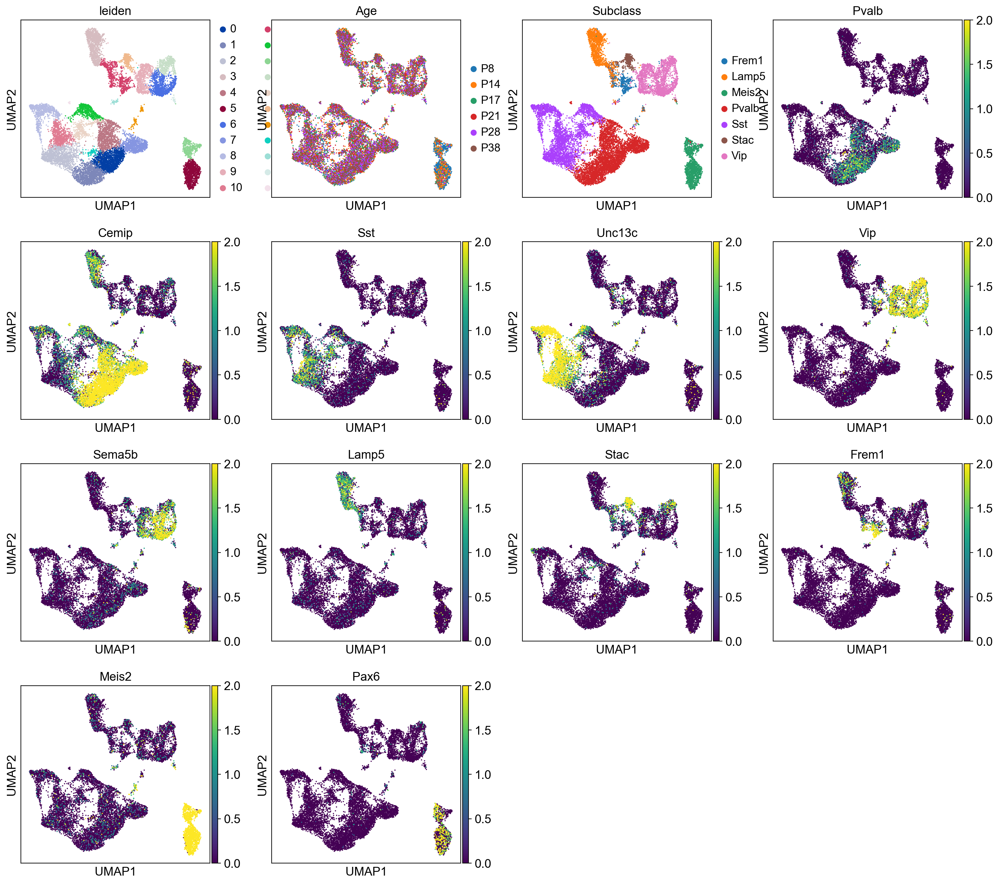

In [65]:
sc.pl.umap(gaba_all, color=['leiden','Age', 'Subclass',
                           'Pvalb', 'Cemip', 
                            'Sst', 'Unc13c',
                            'Vip', 'Sema5b', 
                            'Lamp5', 'Stac', 'Frem1', 
                            'Meis2', 'Pax6'], vmax=2)

In [66]:

gaba_all.write_h5ad(path + 'gaba_all_for_Meis2_separation.h5ad')

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


# Prep objs for each age

In [5]:

gaba_all = sc.read_h5ad(path + 'gaba_all_for_Meis2_separation.h5ad')

In [8]:
#goes from 15k to 13.5k
gaba_all = gaba_all[gaba_all.obs.Subclass!='Meis2',:]

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


In [16]:
gaba_all.X = gaba_all.raw.X.A

In [8]:
def gaba_pipeline(adata):
    sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5) #HVGs
    sc.pp.scale(adata, max_value=10) #scale
    sc.tl.pca(adata, svd_solver='arpack') #run PCA

    Z = harmonize(adata.obsm['X_pca'], adata.obs, batch_key = 'sample')
    adata.obsm['X_harmony'] = Z

    sc.pp.neighbors(adata, n_neighbors=25, use_rep='X_harmony')
    sc.tl.leiden(adata)
    sc.tl.umap(adata)
    
    sc.tl.dendrogram(adata, groupby='leiden', use_rep='X_harmony')
    
    
    return shuffle(adata)

In [107]:
def name_subclass(adata):
    Subclass = []
    for i in range(adata.shape[0]):
        Subclass.append(adata.obs.Type[i].split('_')[0])

    adata.obs['Subclass'] = pd.Categorical(Subclass)

    return adata

In [68]:
P8_gaba = gaba_pipeline(gaba_all[gaba_all.obs.Age=='P8',:])
P14_gaba = gaba_pipeline(gaba_all[gaba_all.obs.Age=='P14',:])
P17_gaba = gaba_pipeline(gaba_all[gaba_all.obs.Age=='P17',:])
P21_gaba = gaba_pipeline(gaba_all[gaba_all.obs.Age=='P21',:])
P28_gaba = gaba_pipeline(gaba_all[gaba_all.obs.Age=='P28',:])
P38_gaba = gaba_pipeline(gaba_all[gaba_all.obs.Age=='P38',:])

extracting highly variable genes


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    finished (0:00:01)


Trying to set attribute `.uns` of view, copying.


--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)
	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
	Completed 4 / 10 iteration(s).
	Completed 5 / 10 iteration(s).
	Completed 6 / 10 iteration(s).
Reach convergence after 6 iteration(s).
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 14 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:03)
Storing dendrogram info using `.uns["dendro

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    finished (0:00:01)


Trying to set attribute `.uns` of view, copying.


--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:01)
	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
	Completed 4 / 10 iteration(s).
	Completed 5 / 10 iteration(s).
	Completed 6 / 10 iteration(s).
Reach convergence after 6 iteration(s).
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 16 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:05)
Storing dendrogram info using `.uns["dendro

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    finished (0:00:01)


Trying to set attribute `.uns` of view, copying.


--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:01)
	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
	Completed 4 / 10 iteration(s).
	Completed 5 / 10 iteration(s).
	Completed 6 / 10 iteration(s).
Reach convergence after 6 iteration(s).
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 16 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:05)
Storing dendrogram info using `.uns["dendro

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    finished (0:00:01)


Trying to set attribute `.uns` of view, copying.


--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:01)
	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
	Completed 4 / 10 iteration(s).
	Completed 5 / 10 iteration(s).
	Completed 6 / 10 iteration(s).
	Completed 7 / 10 iteration(s).
	Completed 8 / 10 iteration(s).
Reach convergence after 8 iteration(s).
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 16 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (a

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    finished (0:00:01)


Trying to set attribute `.uns` of view, copying.


--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)
	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
	Completed 4 / 10 iteration(s).
	Completed 5 / 10 iteration(s).
	Completed 6 / 10 iteration(s).
	Completed 7 / 10 iteration(s).
Reach convergence after 7 iteration(s).
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 16 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:04)
Storing den

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    finished (0:00:00)


Trying to set attribute `.uns` of view, copying.


--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)
	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
	Completed 4 / 10 iteration(s).
	Completed 5 / 10 iteration(s).
	Completed 6 / 10 iteration(s).
	Completed 7 / 10 iteration(s).
	Completed 8 / 10 iteration(s).
	Completed 9 / 10 iteration(s).
Reach convergence after 9 iteration(s).
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 17 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
 

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


Text(0, 0.5, '# Clusters')

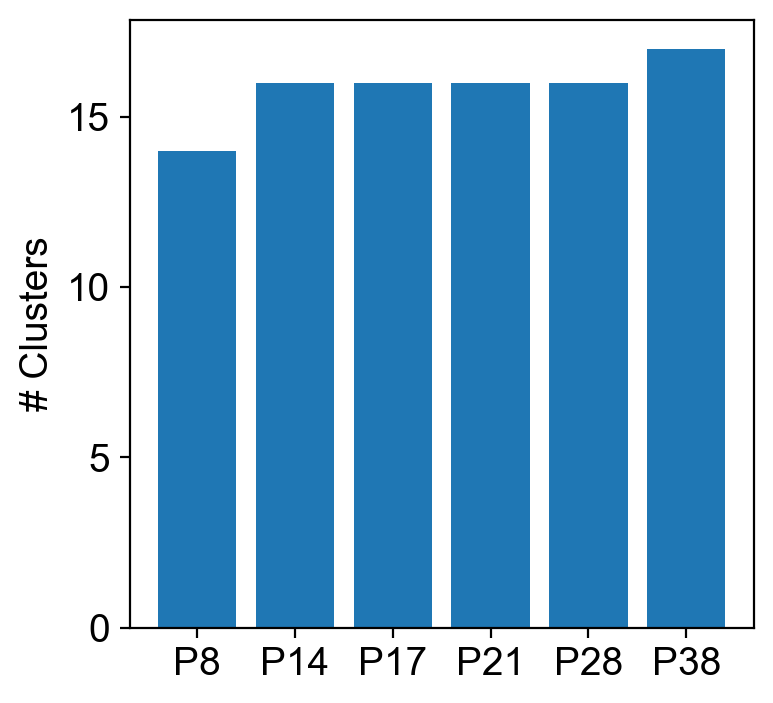

In [69]:
plt.bar(['P8', 'P14', 'P17', 'P21', 'P28', 'P38'], 
       [14, 16, 16, 16, 16, 17])
plt.grid(False)
plt.ylabel('# Clusters')

Text(0, 0.5, '# Cells')

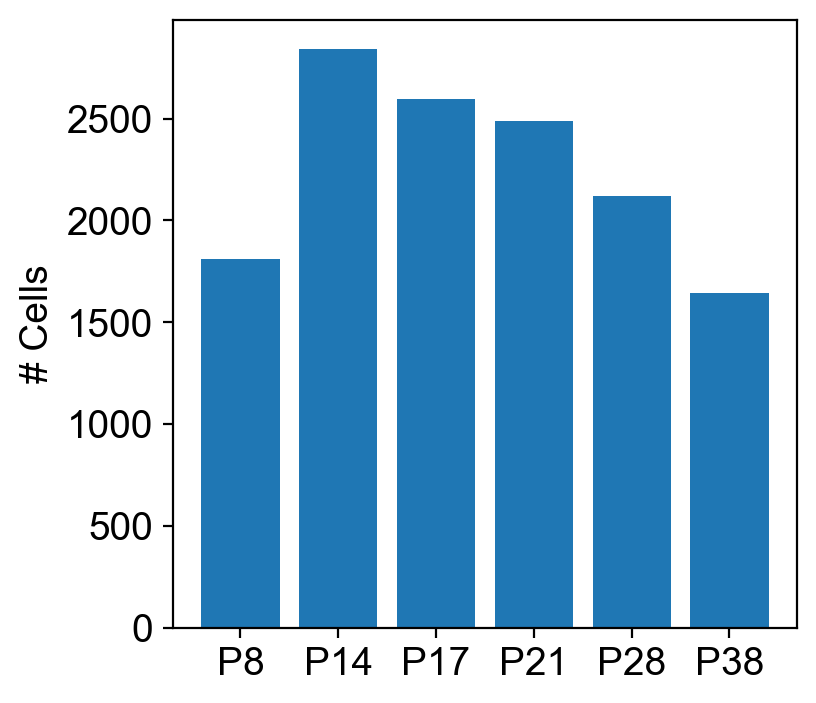

In [87]:
plt.bar(['P8', 'P14', 'P17', 'P21', 'P28', 'P38'], 
       [1811, 2844, 2598, 2487, 2119, 1642])
plt.grid(False)
plt.ylabel('# Cells')

# Read in for refinement

In [3]:

P8_gaba = sc.read_h5ad(path_out + 'P8_gaba_March.h5ad')
P14_gaba = sc.read_h5ad(path_out + 'P14_gaba_March.h5ad')
P17_gaba = sc.read_h5ad(path_out + 'P17_gaba_March.h5ad')
P21_gaba = sc.read_h5ad(path_out + 'P21_gaba_March.h5ad')
P28_gaba = sc.read_h5ad(path_out + 'P28_gaba_March.h5ad')
P38_gaba = sc.read_h5ad(path_out + 'P38_gaba_March.h5ad')

In [16]:
#repeated for all ages
del P38_gaba.obs['cluster']
del P38_gaba.obs['cluster_name']

# P8

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
Trying to set attribute `.uns` of view, copying.


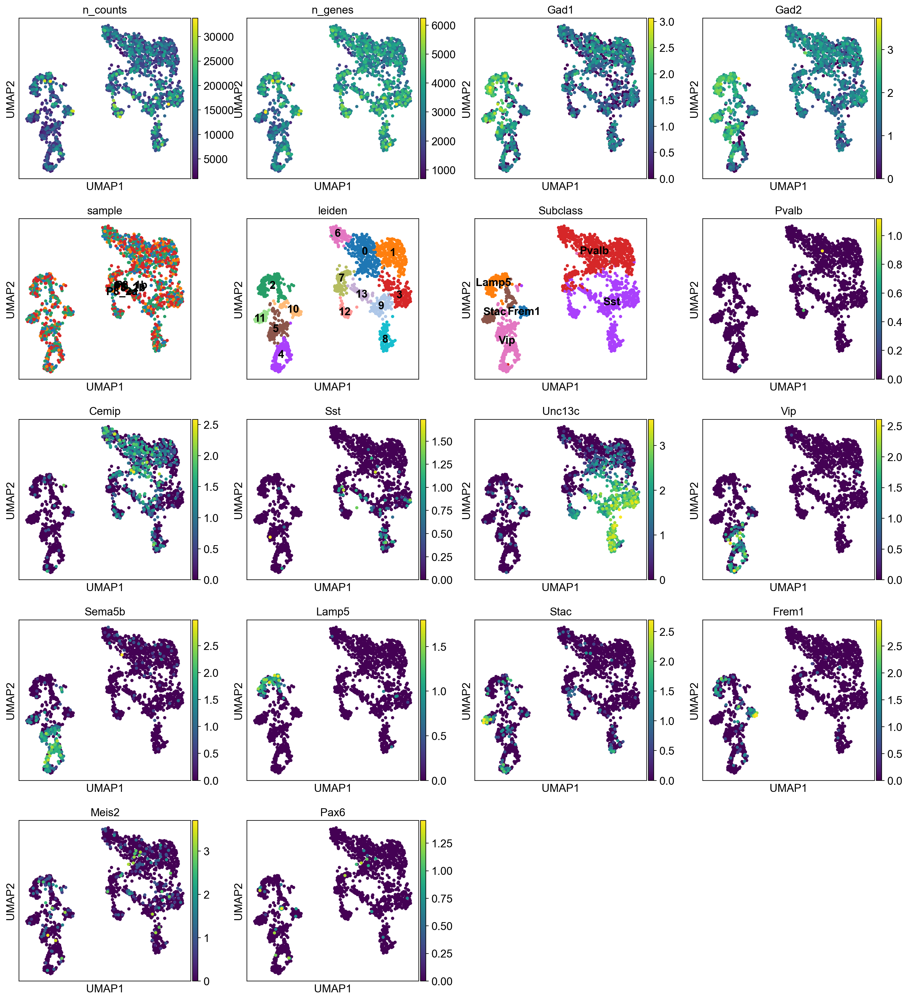

In [70]:
sc.pl.umap(P8_gaba, color=['n_counts', 'n_genes', 'Gad1', 'Gad2', 
                           'sample', 'leiden', 'Subclass', 
                          'Pvalb', 'Cemip', 
                           'Sst', 'Unc13c',
                           'Vip', 'Sema5b', 
                           'Lamp5', 'Stac', 'Frem1', 
                           'Meis2', 'Pax6'], legend_loc='on data')

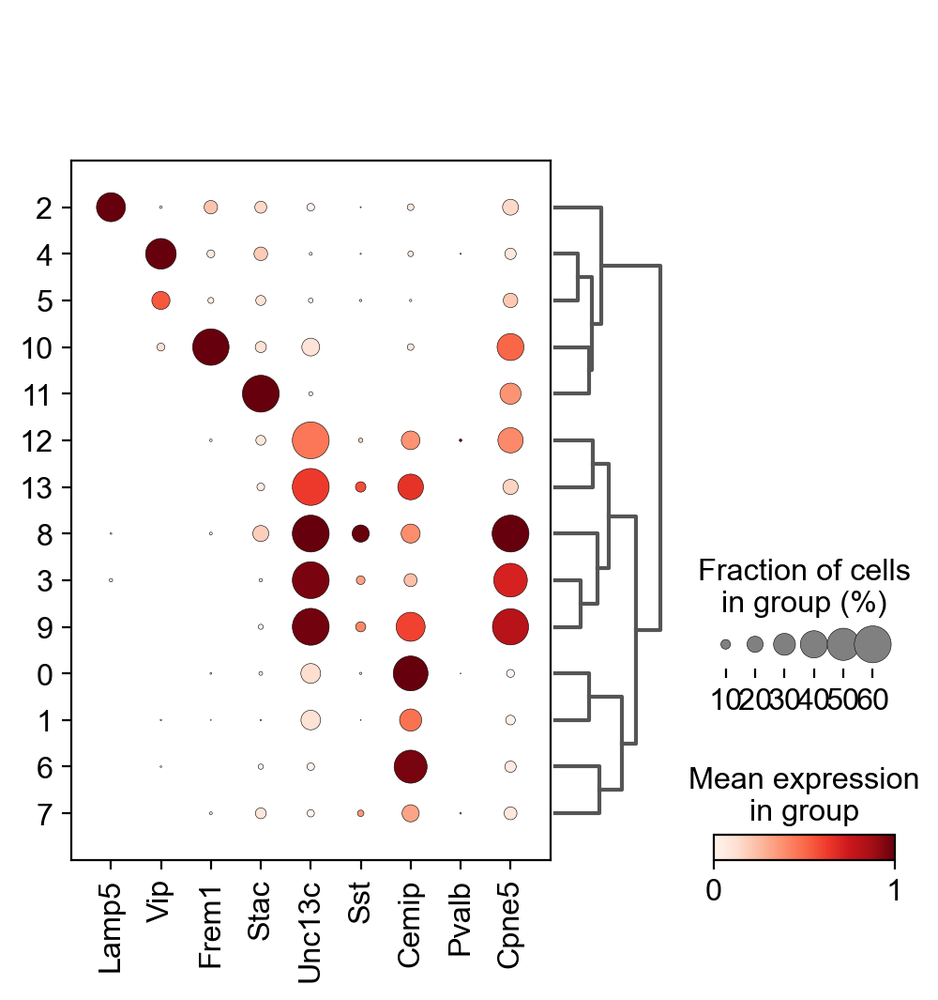

In [71]:
layer_markers = ['Slc17a7',
    'Cux2', 'Ccbe1', 'Mdga1', 
              'Whrn', 'Rorb',
              'Deptor', 
              'Nxph1', 'Tshz2', 'Trhr', 'Slc17a8', 
              'Bcl6', 'Erg', 'Reln', 
              'Cdh9', 'Zfp804b',
              'Foxp2', 'Syt6',
              'Ctgf', 'Inpp4b', 'Svil']

bias_markers = ['Lamp5',
                'Vip',
                'Frem1',
                'Stac',
                'Unc13c', 'Sst',
                 'Cemip', 'Pvalb', 'Cpne5']

sc.pl.dotplot(P8_gaba, bias_markers, groupby='leiden', 
                   dendrogram=True, standard_scale='var', dot_max=0.6)
#sc.pl.dotplot(P8_gaba, layer_markers, groupby='cluster_name', dendrogram=True)

In [57]:
P8_gaba = sc.read_h5ad(path_out + 'P8_gaba_March.h5ad')

In [58]:
P8_gaba.obs.leiden.values.categories

Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13'],
      dtype='object')

In [59]:
Type = ['Pvalb_A', 'Pvalb_B', 'Lamp5', 'Sst_A', 'Vip_A', 'Vip_B', 
        'Pvalb_C', 'Pvalb_D', 'Sst_B', 'Sst_C', 'Frem1', 'Stac', 'Sst_D', 'Sst_E' ] 

P8_gaba.obs['Type'] = P8_gaba.obs['leiden']
a = P8_gaba.obs['Type']
P8_gaba.obs['Type'] = a.cat.rename_categories(Type).values

In [60]:
sc.tl.dendrogram(P8_gaba, groupby='Type', use_rep='X_harmony')

Storing dendrogram info using `.uns["dendrogram_['Type']"]`


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


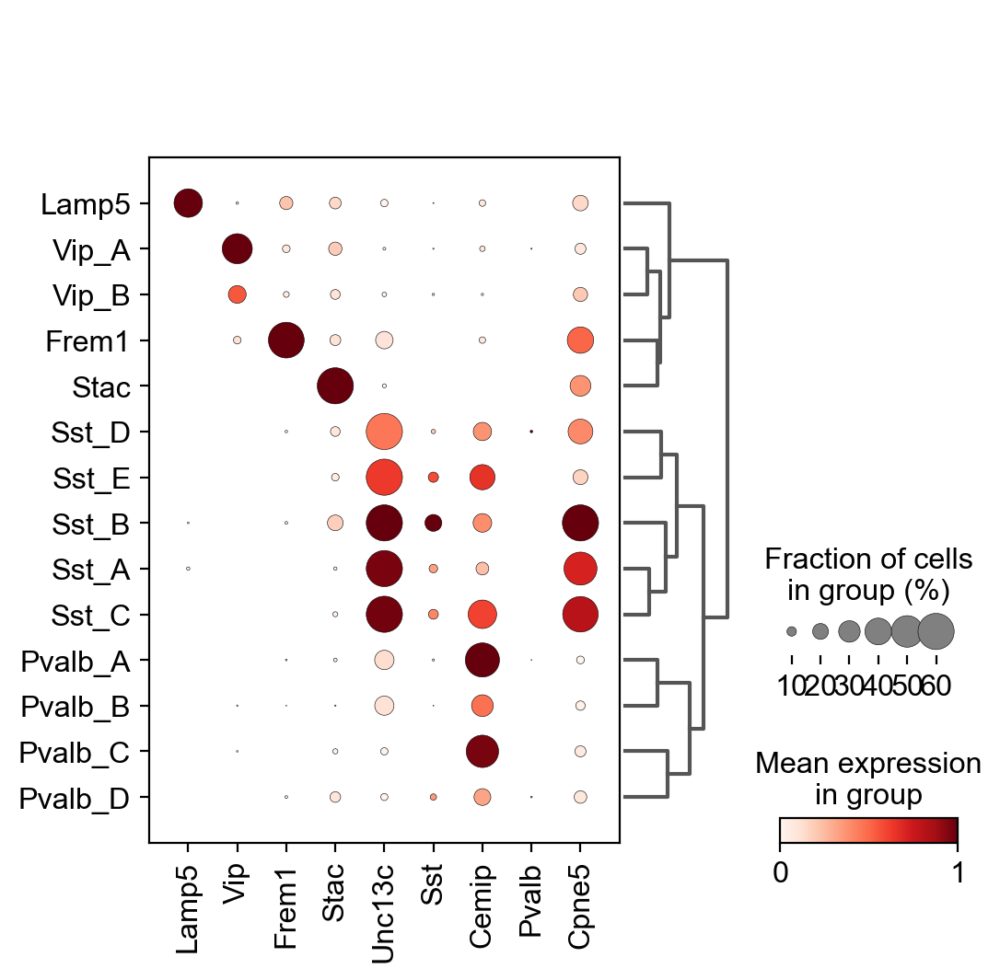

In [61]:
bias_markers = ['Lamp5',
                'Vip',
                'Frem1',
                'Stac',
                'Unc13c', 'Sst',
                 'Cemip', 'Pvalb', 'Cpne5']

sc.pl.dotplot(P8_gaba, bias_markers, groupby='Type', 
                   dendrogram=True, standard_scale='var', dot_max=0.6)

# P14

Trying to set attribute `.uns` of view, copying.


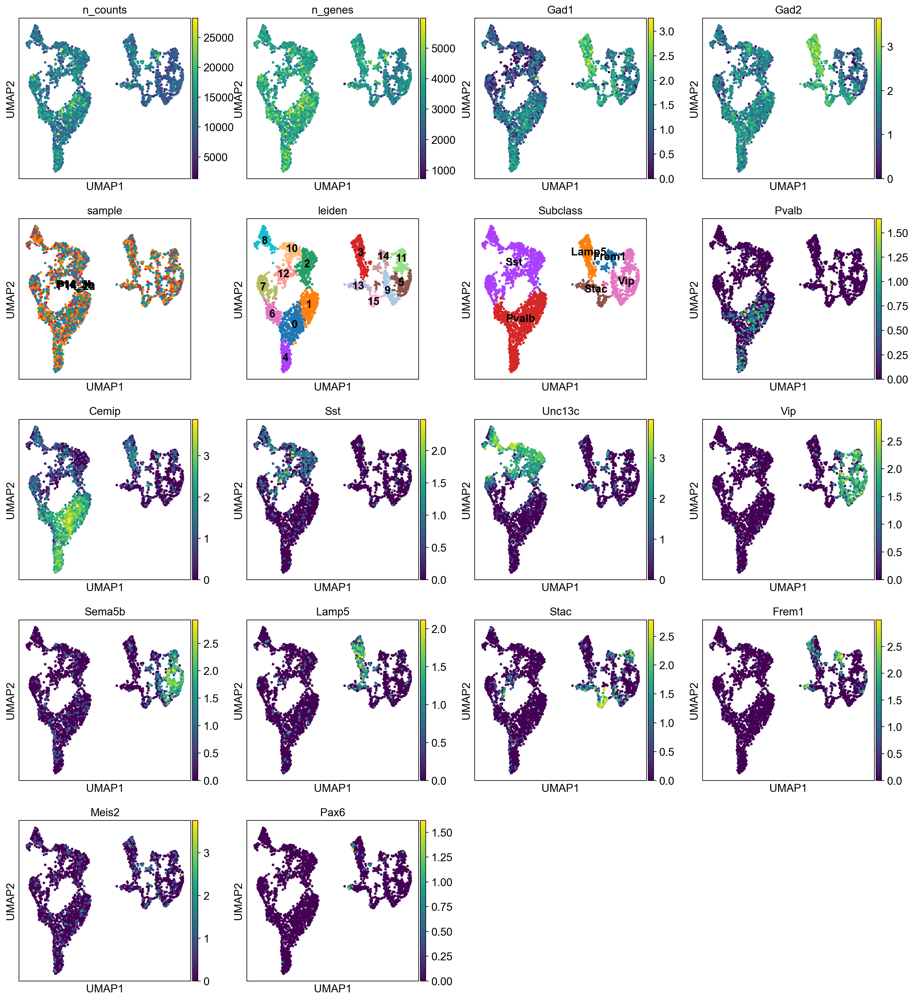

In [73]:
sc.pl.umap(P14_gaba, color=['n_counts', 'n_genes', 'Gad1', 'Gad2', 
                           'sample', 'leiden', 'Subclass', 
                          'Pvalb', 'Cemip', 
                           'Sst', 'Unc13c',
                           'Vip', 'Sema5b', 
                           'Lamp5', 'Stac', 'Frem1', 
                           'Meis2', 'Pax6'], legend_loc='on data')

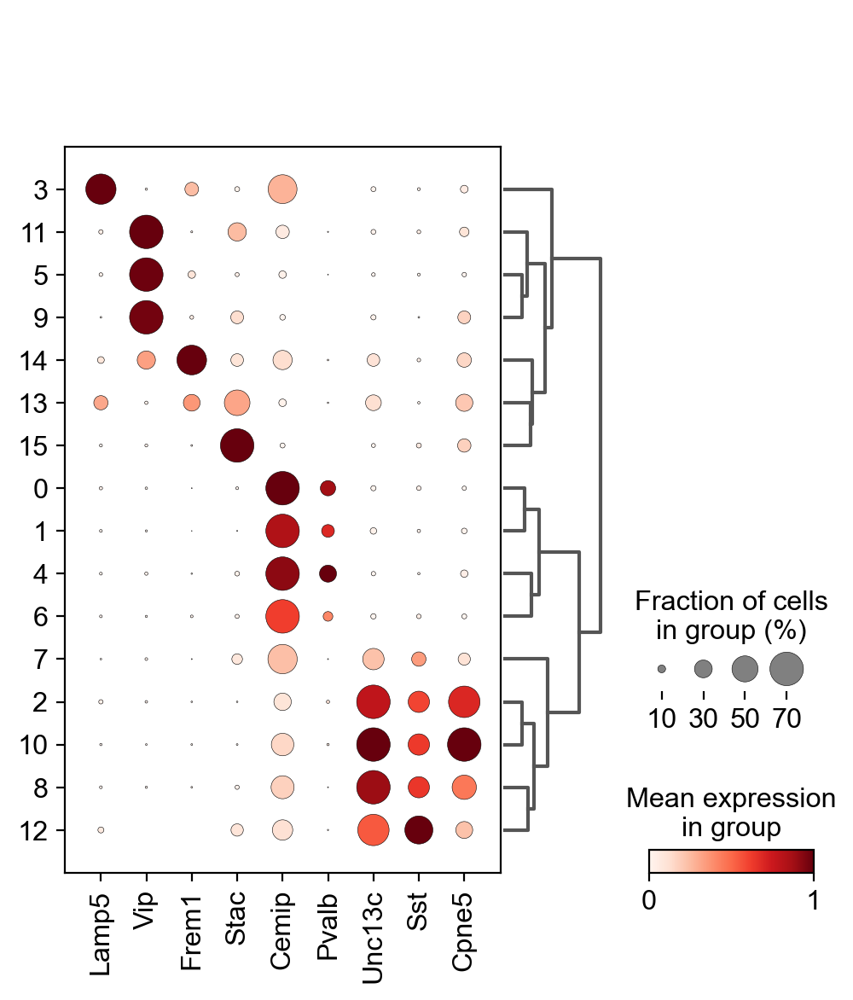

In [67]:
layer_markers = ['Slc17a7',
    'Cux2', 'Ccbe1', 'Mdga1', 
              'Whrn', 'Rorb',
              'Deptor', 
              'Nxph1', 'Tshz2', 'Trhr', 'Slc17a8', 
              'Bcl6', 'Erg', 'Reln', 
              'Cdh9', 'Zfp804b',
              'Foxp2', 'Syt6',
              'Ctgf', 'Inpp4b', 'Svil']

bias_markers = ['Lamp5',
                'Vip',
                'Frem1',
                'Stac',
                'Cemip', 'Pvalb',
                'Unc13c', 'Sst',
                  'Cpne5']

sc.pl.dotplot(P14_gaba, bias_markers, groupby='leiden', 
                   dendrogram=True, standard_scale='var', dot_max=0.7)
#sc.pl.dotplot(P14_gaba, layer_markers, groupby='cluster_name', dendrogram=True)

In [62]:
P14_gaba = sc.read_h5ad(path_out + 'P14_gaba_March.h5ad')

In [64]:
P14_gaba.obs.leiden.values.categories

Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15'],
      dtype='object')

In [68]:
Type = ['Pvalb_A', 'Pvalb_B', 'Sst_A', 'Lamp5_A', 'Pvalb_C', 'Vip_A', 'Pvalb_D', 
        'Sst_D', 'Sst_B', 'Vip_B', 'Sst_C', 'Vip_C', 'Sst_E',
       'Lamp5_B', 'Frem1', 'Stac' ] 

P14_gaba.obs['Type'] = P14_gaba.obs['leiden']
a = P14_gaba.obs['Type']
P14_gaba.obs['Type'] = a.cat.rename_categories(Type).values

sc.tl.dendrogram(P14_gaba, groupby='Type', use_rep='X_harmony')

Storing dendrogram info using `.uns["dendrogram_['Type']"]`


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


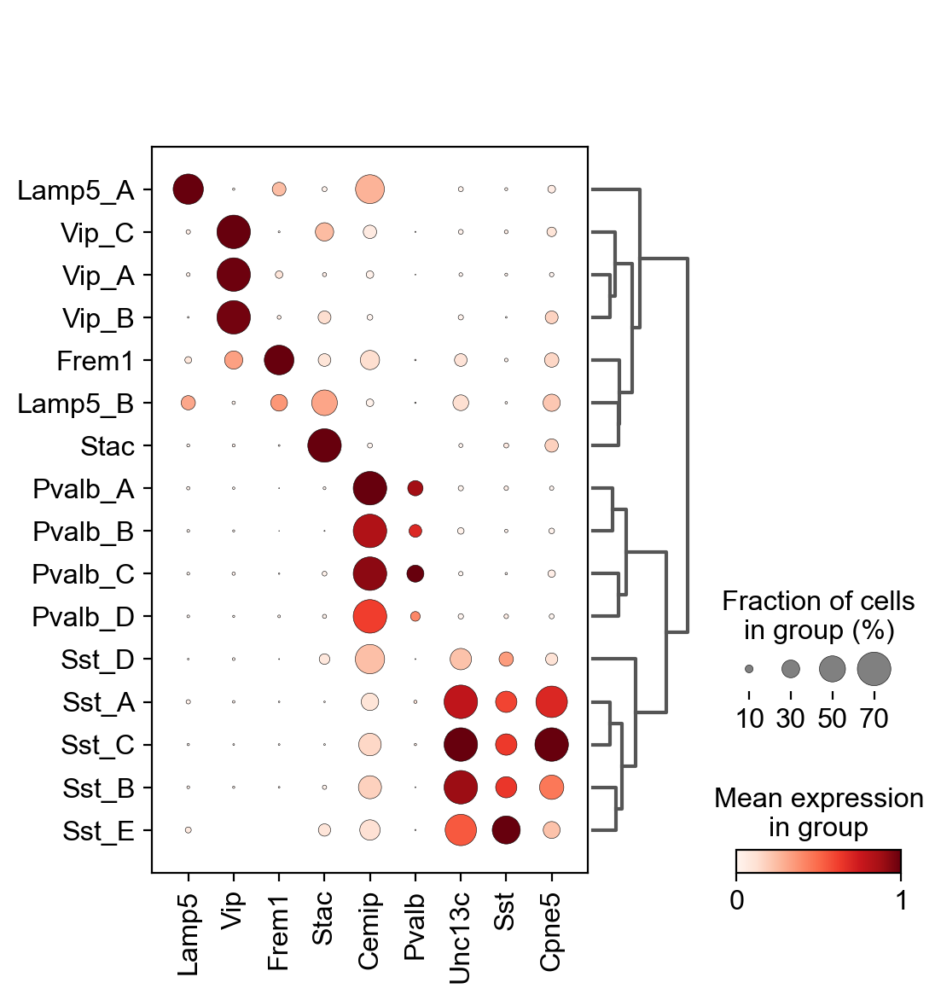

In [69]:
sc.pl.dotplot(P14_gaba, bias_markers, groupby='Type', 
                   dendrogram=True, standard_scale='var', dot_max=0.7)

# P17

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
Trying to set attribute `.uns` of view, copying.


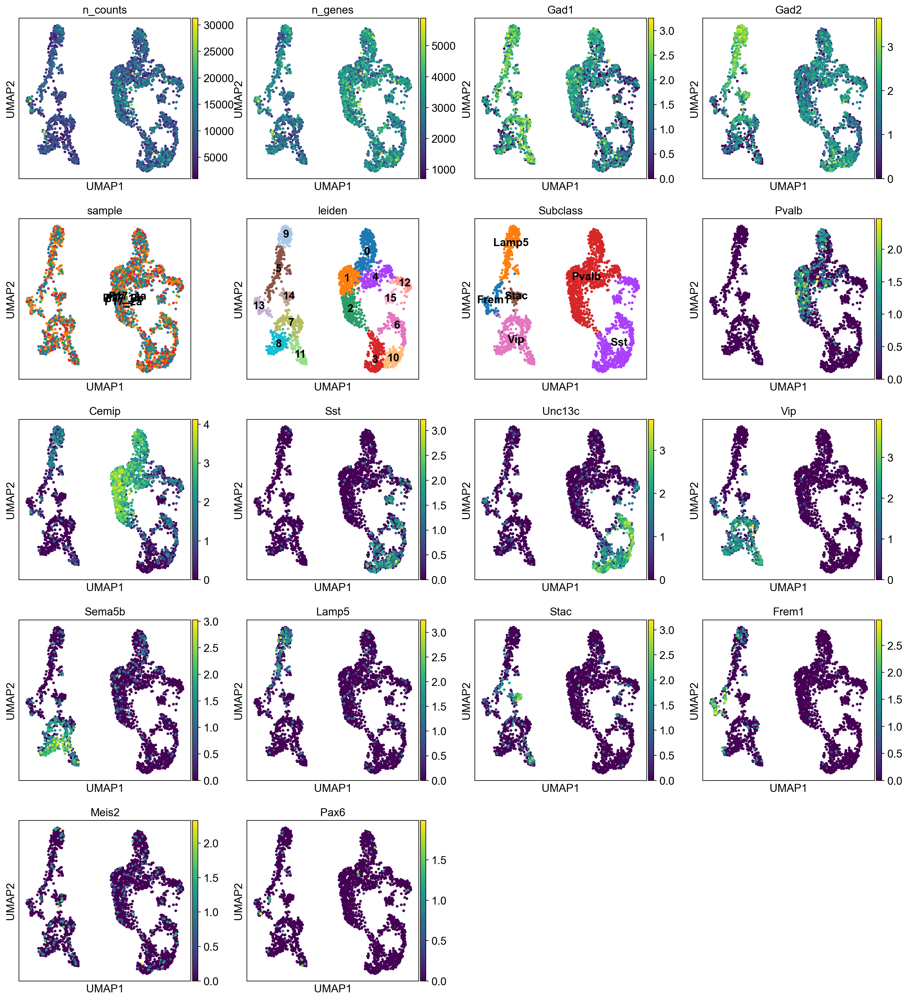

In [79]:
sc.pl.umap(P17_gaba, color=['n_counts', 'n_genes', 'Gad1', 'Gad2', 
                           'sample', 'leiden', 'Subclass', 
                          'Pvalb', 'Cemip', 
                           'Sst', 'Unc13c',
                           'Vip', 'Sema5b', 
                           'Lamp5', 'Stac', 'Frem1', 
                           'Meis2', 'Pax6'], legend_loc='on data')

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


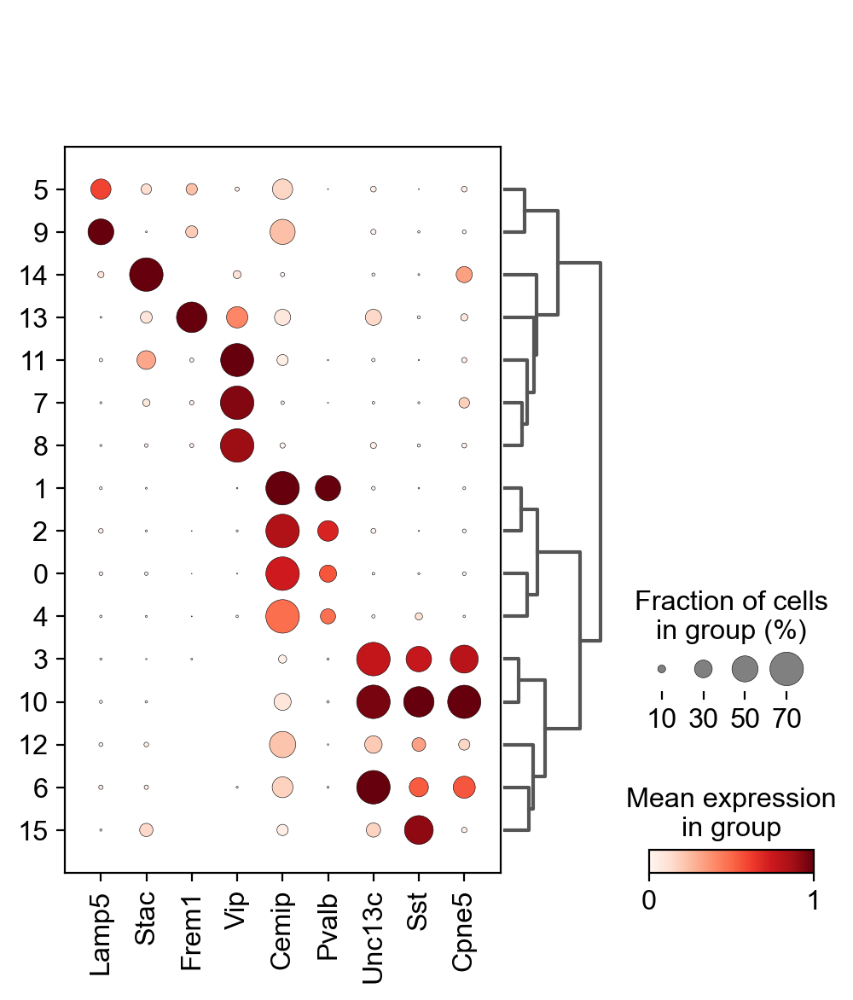

In [81]:
layer_markers = ['Slc17a7',
    'Cux2', 'Ccbe1', 'Mdga1', 
              'Whrn', 'Rorb',
              'Deptor', 
              'Nxph1', 'Tshz2', 'Trhr', 'Slc17a8', 
              'Bcl6', 'Erg', 'Reln', 
              'Cdh9', 'Zfp804b',
              'Foxp2', 'Syt6',
              'Ctgf', 'Inpp4b', 'Svil']

bias_markers = ['Lamp5',
                'Stac',
                'Frem1',
                'Vip',
                
                'Cemip', 'Pvalb',
                'Unc13c', 'Sst',
                  'Cpne5']

sc.pl.dotplot(P17_gaba, bias_markers, groupby='leiden', 
                   dendrogram=True, standard_scale='var', dot_max=0.7)
#sc.pl.dotplot(P17_gaba, layer_markers, groupby='cluster_name', dendrogram=True)

In [70]:
P17_gaba = sc.read_h5ad(path_out + 'P17_gaba_March.h5ad')

In [71]:
P17_gaba.obs.leiden.values.categories

Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15'],
      dtype='object')

In [72]:
Type = ['Pvalb_C', 'Pvalb_A', 'Pvalb_B', 'Sst_A', 'Pvalb_D', 'Lamp5_B', 'Sst_B', 
        'Vip_B', 'Vip_A', 'Lamp5_A', 'Sst_C', 'Vip_C', 'Sst_D',
       'Frem1', 'Stac', 'Sst_E' ] 

P17_gaba.obs['Type'] = P17_gaba.obs['leiden']
a = P17_gaba.obs['Type']
P17_gaba.obs['Type'] = a.cat.rename_categories(Type).values

sc.tl.dendrogram(P17_gaba, groupby='Type', use_rep='X_harmony')

Storing dendrogram info using `.uns["dendrogram_['Type']"]`


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


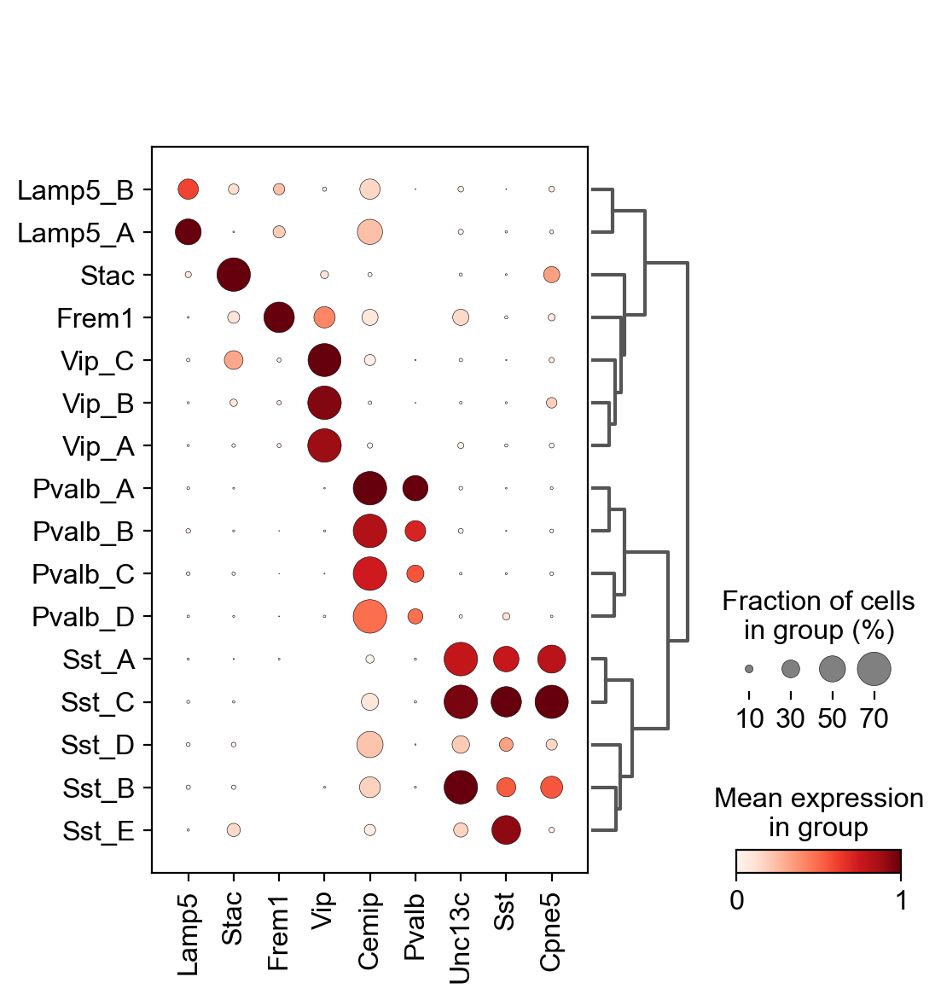

In [73]:
bias_markers = ['Lamp5',
                'Stac',
                'Frem1',
                'Vip',
                
                'Cemip', 'Pvalb',
                'Unc13c', 'Sst',
                  'Cpne5']

sc.pl.dotplot(P17_gaba, bias_markers, groupby='Type', 
                   dendrogram=True, standard_scale='var', dot_max=0.7)

# P21

In [8]:
#remove C14 and C15 from first clustering: 
#no specific mapping to next time point and low validation
P21_gaba = P21_gaba[P21_gaba.obs.leiden!='14']
P21_gaba = P21_gaba[P21_gaba.obs.leiden!='15']

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


In [22]:
P21_gaba.X = P21_gaba.raw.X
P21_gaba = gaba_pipeline(P21_gaba)

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    on highly variable genes
    with n_comps=50


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


    finished (0:00:01)
	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
	Completed 4 / 10 iteration(s).
	Completed 5 / 10 iteration(s).
	Completed 6 / 10 iteration(s).
	Completed 7 / 10 iteration(s).
	Completed 8 / 10 iteration(s).
Reach convergence after 8 iteration(s).
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 15 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:04)
Storing dendrogram info using `.uns["dendrogram_['leiden']"]`


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


* After second round of Sankey, C14 (low Sst), while learnable, doesn't get mapping from prev timepoint nor maps to subsequent time point.
* also, C1 here maps to 3 cluster equally in next time

Let's see what effect taking out C14 has on the above two points. 

In [75]:
P21_gaba = P21_gaba[P21_gaba.obs.leiden!='14']
P21_gaba.X = P21_gaba.raw.X.A
P21_gaba = gaba_pipeline(P21_gaba)

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


extracting highly variable genes
    finished (0:00:01)


Trying to set attribute `.uns` of view, copying.


--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:01)
	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
	Completed 4 / 10 iteration(s).
	Completed 5 / 10 iteration(s).
	Completed 6 / 10 iteration(s).
	Completed 7 / 10 iteration(s).
Reach convergence after 7 iteration(s).
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 14 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:05)
Storing den

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
Trying to set attribute `.uns` of view, copying.


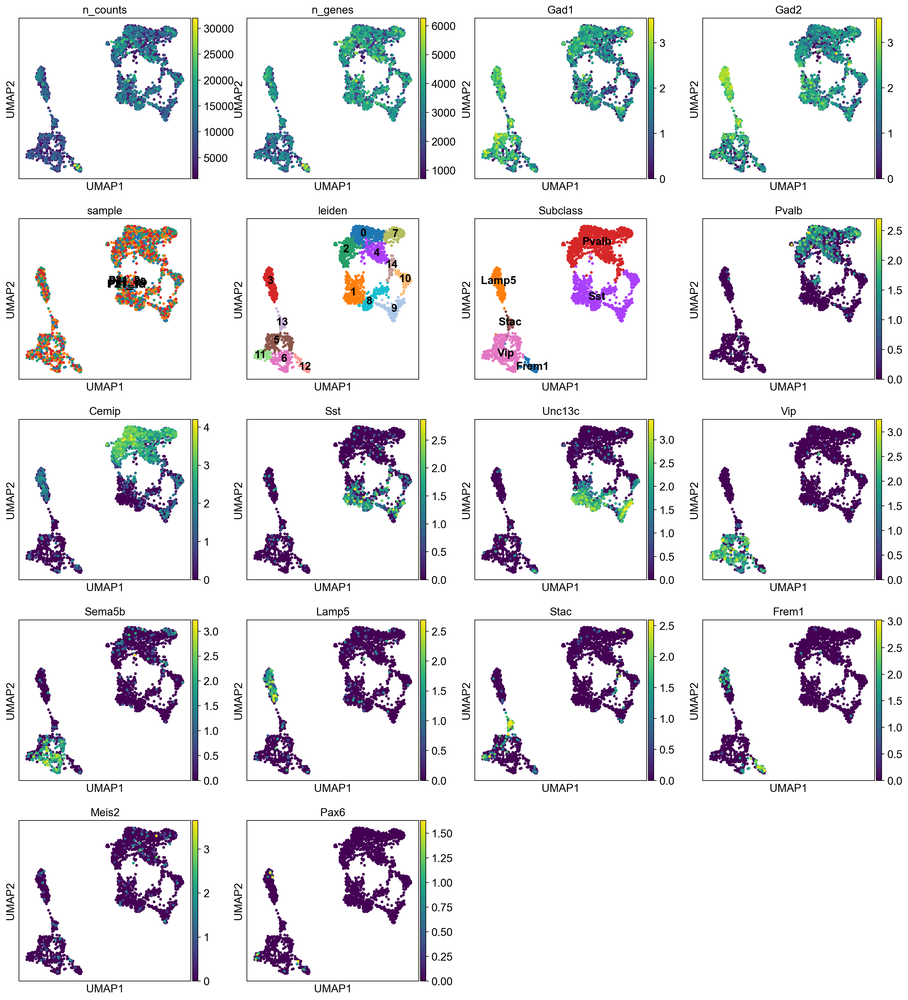

In [23]:
#before above markdown cell
sc.pl.umap(P21_gaba, color=['n_counts', 'n_genes', 'Gad1', 'Gad2', 
                           'sample', 'leiden', 'Subclass', 
                          'Pvalb', 'Cemip', 
                           'Sst', 'Unc13c',
                           'Vip', 'Sema5b', 
                           'Lamp5', 'Stac', 'Frem1', 
                           'Meis2', 'Pax6'], legend_loc='on data')

In [81]:
#to get 5 SSTs: to 1.5 first
#sc.tl.leiden(P21_gaba, resolution=1.50)
#P21_gaba = P21_gaba[P21_gaba.obs.leiden!='16']


sc.tl.leiden(P21_gaba, resolution=1.20)

running Leiden clustering


Trying to set attribute `.obs` of view, copying.


    finished: found 16 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


merge 12 and 9 to 9

In [84]:
leiden_new21 = []
for i in range(P21_gaba.shape[0]):
    if (P21_gaba.obs.leiden[i] in ('12','9')): leiden_new21.append('9')
    else: leiden_new21.append(P21_gaba.obs.leiden[i])

P21_gaba.obs['leiden'] = pd.Categorical(leiden_new21)

In [85]:
P21_gaba.obs['leiden'].values.categories

Index(['0', '1', '10', '11', '13', '14', '15', '2', '3', '4', '5', '6', '7',
       '8', '9'],
      dtype='object')

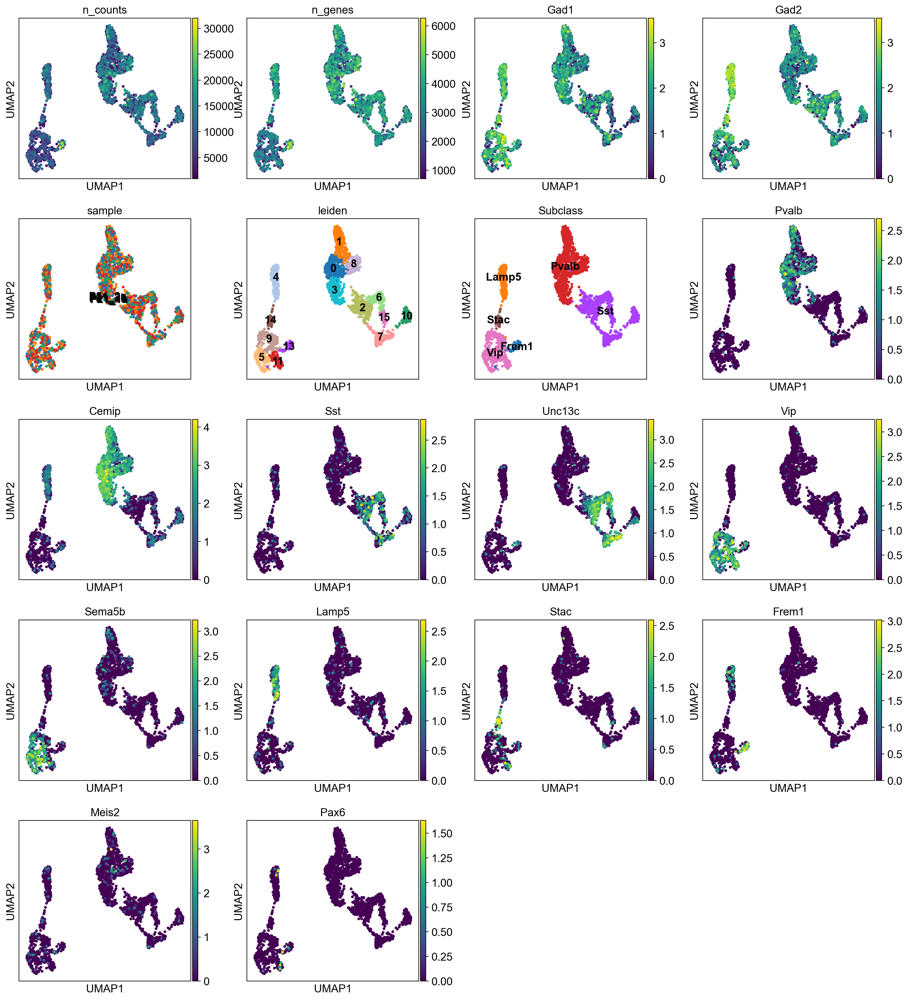

In [86]:
#after above markdown cell
sc.pl.umap(P21_gaba, color=['n_counts', 'n_genes', 'Gad1', 'Gad2', 
                           'sample', 'leiden', 'Subclass', 
                          'Pvalb', 'Cemip', 
                           'Sst', 'Unc13c',
                           'Vip', 'Sema5b', 
                           'Lamp5', 'Stac', 'Frem1', 
                           'Meis2', 'Pax6'], legend_loc='on data')

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


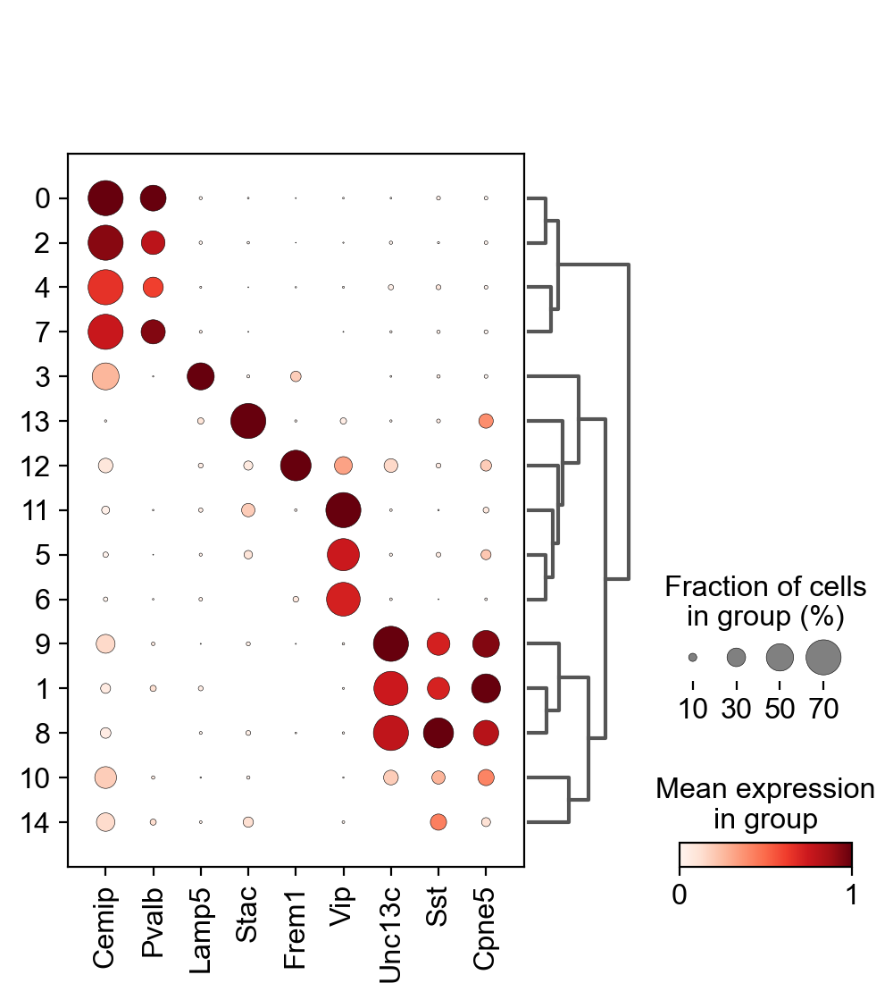

In [25]:
layer_markers = ['Slc17a7',
    'Cux2', 'Ccbe1', 'Mdga1', 
              'Whrn', 'Rorb',
              'Deptor', 
              'Nxph1', 'Tshz2', 'Trhr', 'Slc17a8', 
              'Bcl6', 'Erg', 'Reln', 
              'Cdh9', 'Zfp804b',
              'Foxp2', 'Syt6',
              'Ctgf', 'Inpp4b', 'Svil']

bias_markers = ['Cemip', 'Pvalb',
                'Lamp5',
                'Stac',
                'Frem1',
                 'Vip',
                'Unc13c', 'Sst',
                  'Cpne5',]

sc.pl.dotplot(P21_gaba, bias_markers, groupby='leiden', 
                   dendrogram=True, standard_scale='var', dot_max=0.7)
#sc.pl.dotplot(P21_gaba, layer_markers, groupby='cluster_name', dendrogram=True)

In [87]:
sc.tl.dendrogram(P21_gaba, groupby='leiden', use_rep='X_harmony')

Storing dendrogram info using `.uns["dendrogram_['leiden']"]`


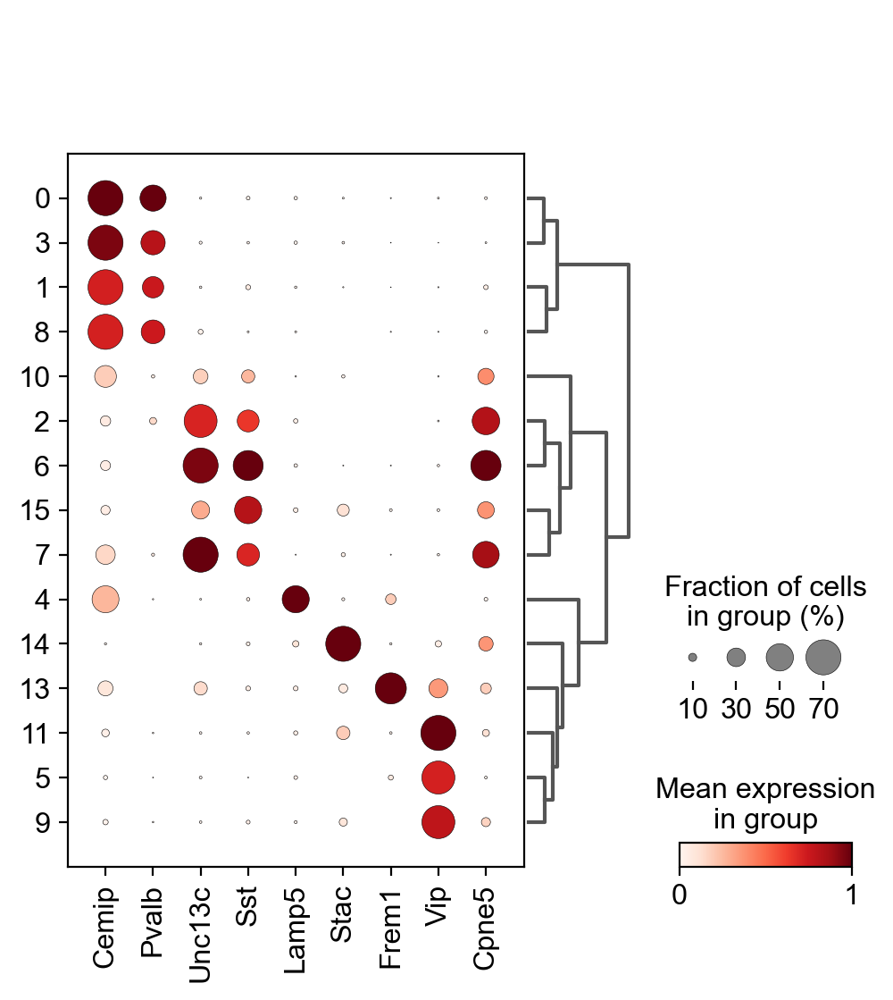

In [88]:
layer_markers = ['Slc17a7',
    'Cux2', 'Ccbe1', 'Mdga1', 
              'Whrn', 'Rorb',
              'Deptor', 
              'Nxph1', 'Tshz2', 'Trhr', 'Slc17a8', 
              'Bcl6', 'Erg', 'Reln', 
              'Cdh9', 'Zfp804b',
              'Foxp2', 'Syt6',
              'Ctgf', 'Inpp4b', 'Svil']

bias_markers = ['Cemip', 'Pvalb',
                 'Unc13c', 'Sst',
                'Lamp5',
                'Stac',
                'Frem1',
                 'Vip',
               
                  'Cpne5',]

sc.pl.dotplot(P21_gaba, bias_markers, groupby='leiden', 
                   dendrogram=True, standard_scale='var', dot_max=0.7)
#sc.pl.dotplot(P21_gaba, layer_markers, groupby='cluster_name', dendrogram=True)

In [89]:
P21_gaba.obs.leiden.values.categories

Index(['0', '1', '10', '11', '13', '14', '15', '2', '3', '4', '5', '6', '7',
       '8', '9'],
      dtype='object')

In [90]:
Type = ['Pvalb_A', 'Pvalb_C', 'Sst_D', 'Vip_C', 'Frem1', 'Stac', 
        'Sst_E', 'Sst_A', 'Pvalb_B', 'Lamp5', 'Vip_A', 'Sst_C', 'Sst_B',
       'Pvalb_D', 'Vip_B'] 

P21_gaba.obs['Type'] = P21_gaba.obs['leiden']
a = P21_gaba.obs['Type']
P21_gaba.obs['Type'] = a.cat.rename_categories(Type).values

sc.tl.dendrogram(P21_gaba, groupby='Type', use_rep='X_harmony')

Storing dendrogram info using `.uns["dendrogram_['Type']"]`


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


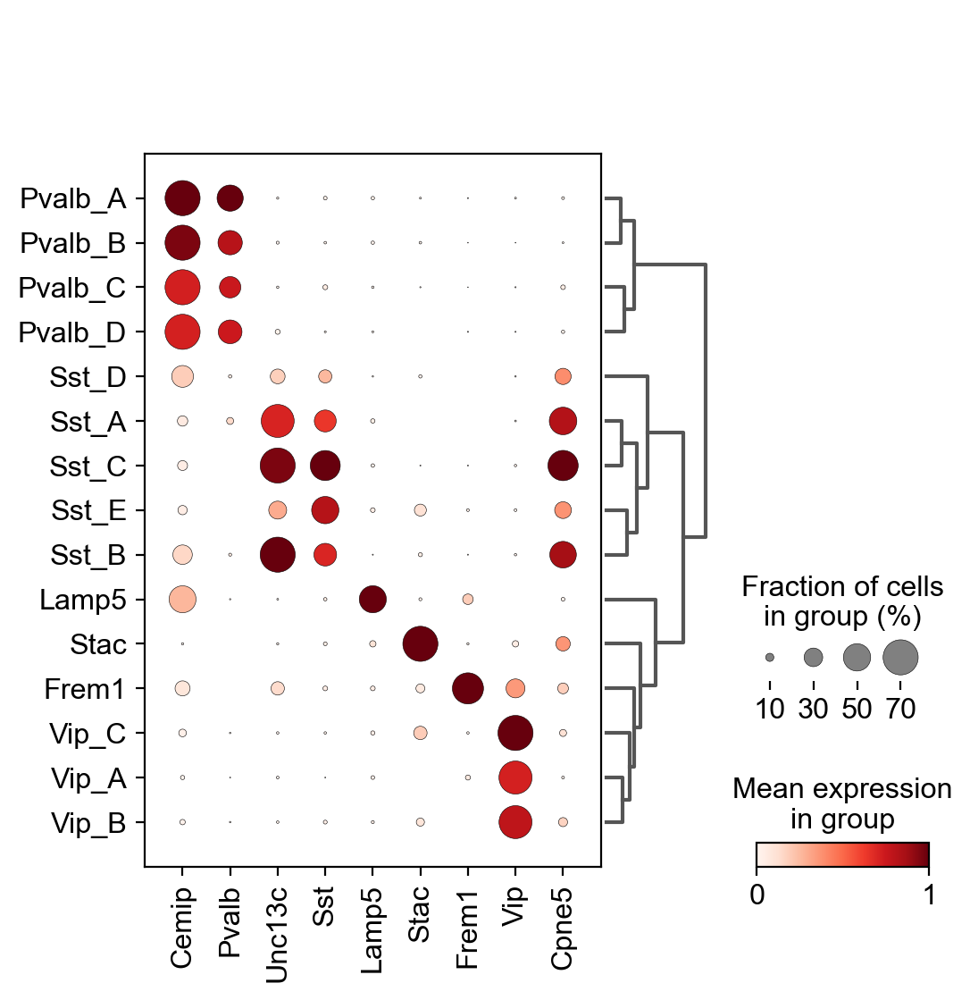

In [91]:
bias_markers = ['Cemip', 'Pvalb',
                 'Unc13c', 'Sst',
                'Lamp5',
                'Stac',
                'Frem1',
                 'Vip',
               
                  'Cpne5',]

sc.pl.dotplot(P21_gaba, bias_markers, groupby='Type', 
                   dendrogram=True, standard_scale='var', dot_max=0.7)

# P28

In [26]:
#remove C15 from first clustering: 
#no specific mapping to next time point and low validation
P28_gaba = P28_gaba[P28_gaba.obs.leiden!='15']

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


In [34]:
P28_gaba.X = P28_gaba.raw.X.A
P28_gaba = gaba_pipeline(P28_gaba)

extracting highly variable genes
    finished (0:00:01)


Trying to set attribute `.uns` of view, copying.


--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:01)
	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
	Completed 4 / 10 iteration(s).
	Completed 5 / 10 iteration(s).
Reach convergence after 5 iteration(s).
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 16 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:04)
Storing dendrogram info using `.uns["dendrogram_['leiden']"]`


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
Trying to set attribute `.uns` of view, copying.


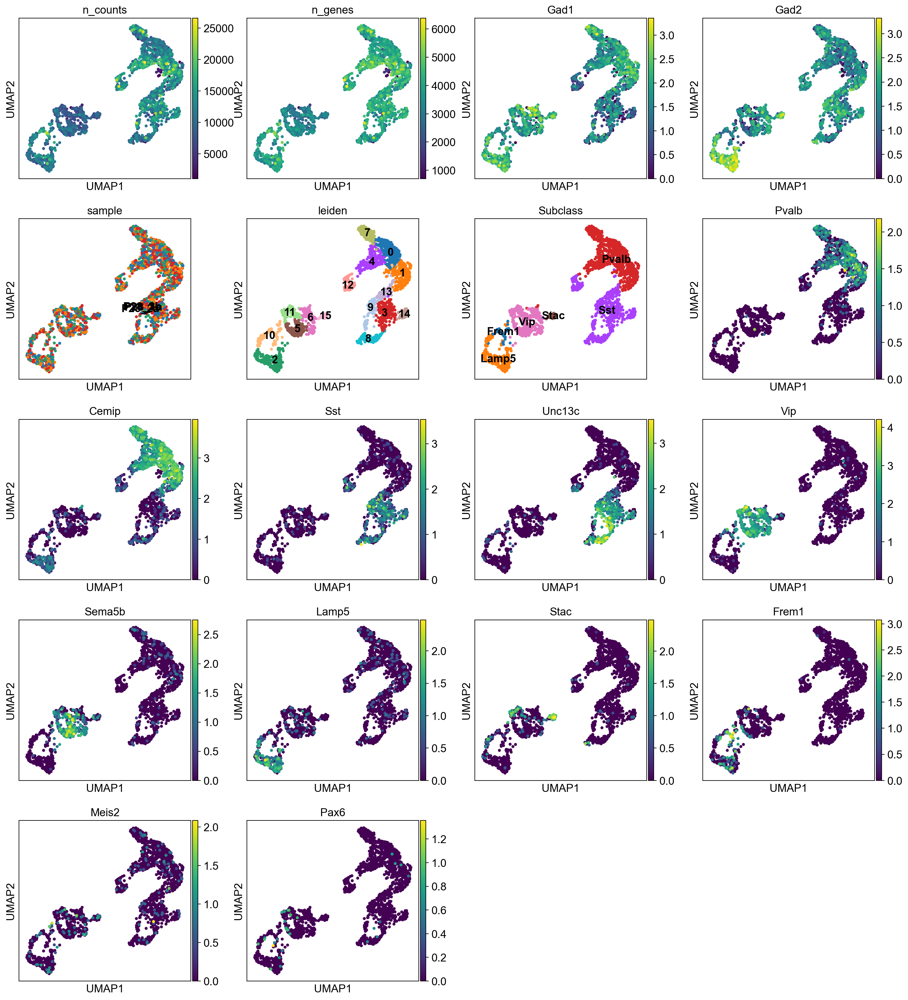

In [35]:
sc.pl.umap(P28_gaba, color=['n_counts', 'n_genes', 'Gad1', 'Gad2', 
                           'sample', 'leiden', 'Subclass', 
                          'Pvalb', 'Cemip', 
                           'Sst', 'Unc13c',
                           'Vip', 'Sema5b', 
                           'Lamp5', 'Stac', 'Frem1', 
                           'Meis2', 'Pax6'], legend_loc='on data')

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


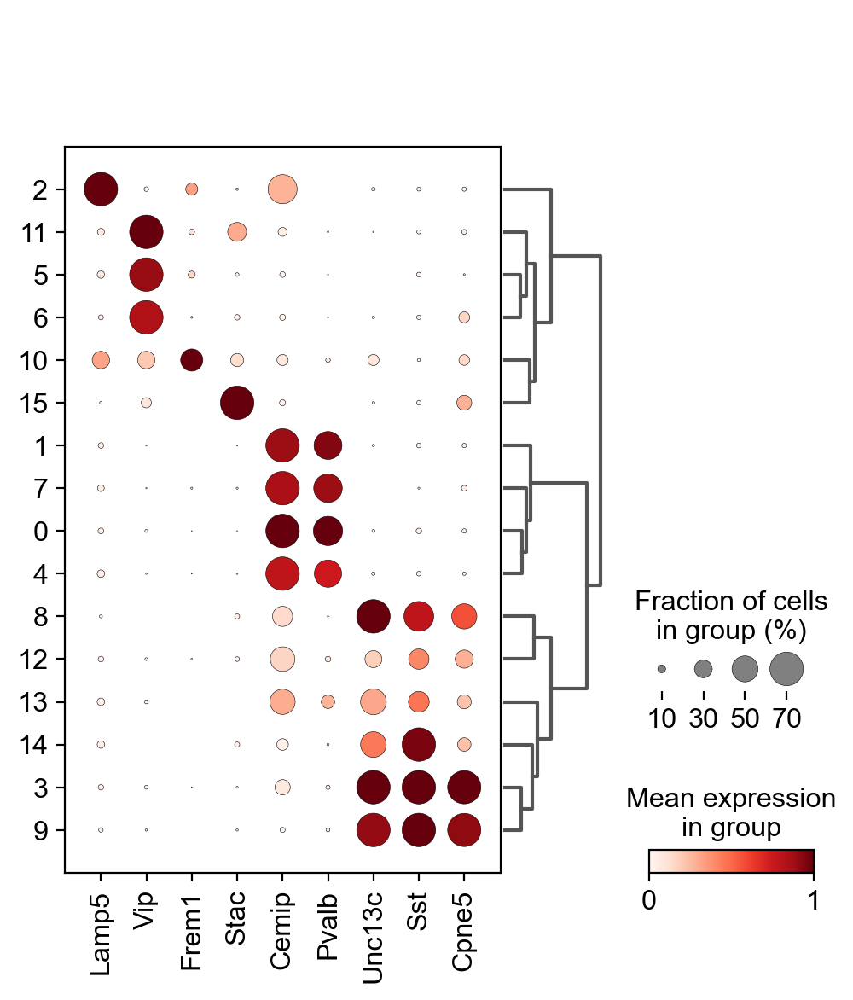

In [37]:
layer_markers = ['Slc17a7',
    'Cux2', 'Ccbe1', 'Mdga1', 
              'Whrn', 'Rorb',
              'Deptor', 
              'Nxph1', 'Tshz2', 'Trhr', 'Slc17a8', 
              'Bcl6', 'Erg', 'Reln', 
              'Cdh9', 'Zfp804b',
              'Foxp2', 'Syt6',
              'Ctgf', 'Inpp4b', 'Svil']

bias_markers = ['Lamp5',
                'Vip',
                'Frem1',
                'Stac',
                'Cemip', 'Pvalb',
                'Unc13c', 'Sst',
                  'Cpne5',]

sc.pl.dotplot(P28_gaba, bias_markers, groupby='leiden', 
                   dendrogram=True, standard_scale='var', dot_max=0.7)
#sc.pl.dotplot(P28_gaba, layer_markers, groupby='cluster_name', dendrogram=True)

In [93]:
P28_gaba = sc.read_h5ad(path_out + 'P28_gaba_March.h5ad')

Merge 13 and 9 b/c both map to Sst_A in P38

In [95]:
leiden_new28 = []
for i in range(P28_gaba.shape[0]):
    if (P28_gaba.obs.leiden[i] in ('9','13')): leiden_new28.append('9')
    else: leiden_new28.append(P28_gaba.obs.leiden[i])

P28_gaba.obs['leiden'] = pd.Categorical(leiden_new28)

In [96]:
P28_gaba.obs.leiden.values.categories

Index(['0', '1', '10', '11', '12', '14', '15', '2', '3', '4', '5', '6', '7',
       '8', '9'],
      dtype='object')

In [97]:
Type = ['Pvalb_A', 'Pvalb_B', 'Frem1', 'Vip_C', 'Sst_D', 'Sst_E', 'Stac',
        'Lamp5', 'Sst_C', 'Pvalb_D', 'Vip_A', 'Vip_B', 'Pvalb_C', 'Sst_B', 'Sst_A', ]

P28_gaba.obs['Type'] = P28_gaba.obs['leiden']
a = P28_gaba.obs['Type']
P28_gaba.obs['Type'] = a.cat.rename_categories(Type).values

sc.tl.dendrogram(P28_gaba, groupby='Type', use_rep='X_harmony')

Storing dendrogram info using `.uns["dendrogram_['Type']"]`


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


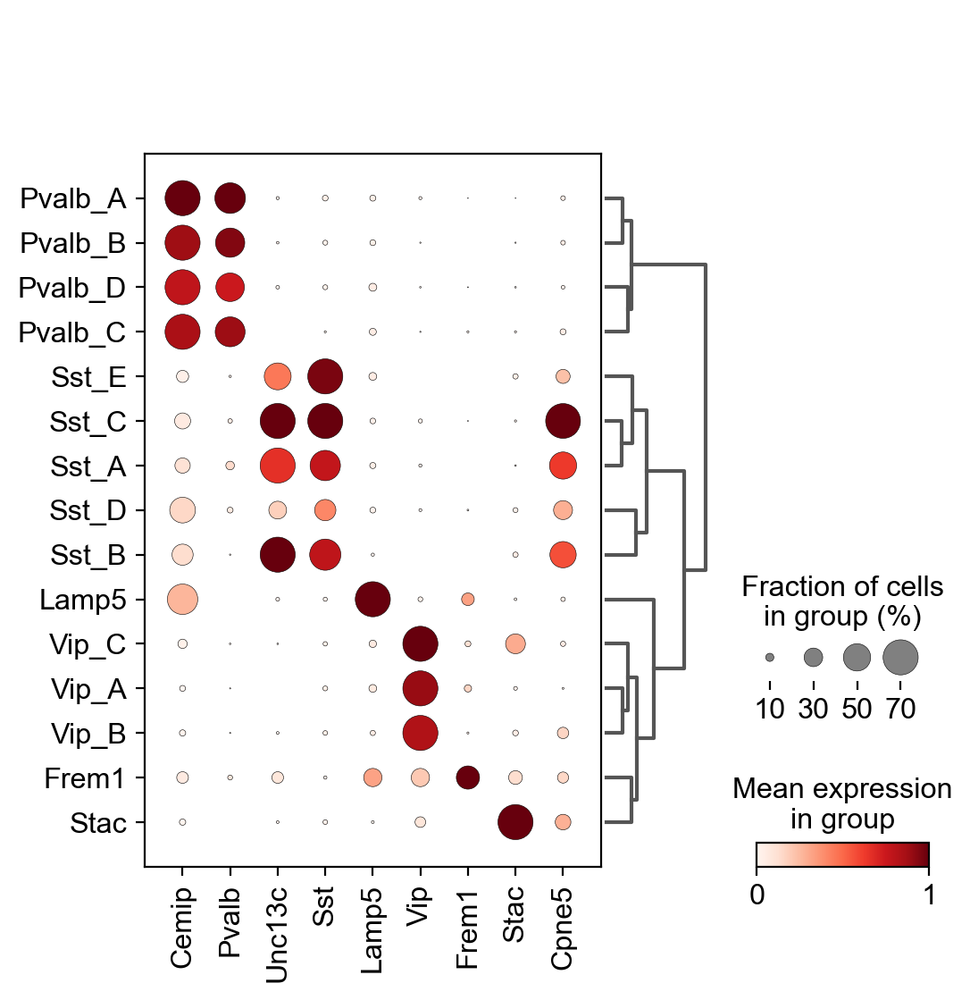

In [99]:
bias_markers = ['Cemip', 'Pvalb',
                'Unc13c', 'Sst',
                'Lamp5',
                'Vip',
                'Frem1',
                'Stac',
                
                  'Cpne5',]

sc.pl.dotplot(P28_gaba, bias_markers, groupby='Type', 
                   dendrogram=True, standard_scale='var', dot_max=0.7)

# P38

#remove C16 from first clustering: 
#no specific mapping to next time point and low validation
P38_gaba = P38_gaba[P38_gaba.obs.leiden!='16']

In [46]:
#after re-clustering 
P38_gaba = P38_gaba[P38_gaba.obs.leiden!='14']

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


In [47]:
P38_gaba.X = P38_gaba.raw.X.A
P38_gaba = gaba_pipeline(P38_gaba)

extracting highly variable genes
    finished (0:00:01)


Trying to set attribute `.uns` of view, copying.


--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)
	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
	Completed 4 / 10 iteration(s).
	Completed 5 / 10 iteration(s).
	Completed 6 / 10 iteration(s).
	Completed 7 / 10 iteration(s).
	Completed 8 / 10 iteration(s).
	Completed 9 / 10 iteration(s).
Reach convergence after 9 iteration(s).
computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 16 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
 

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
Trying to set attribute `.uns` of view, copying.


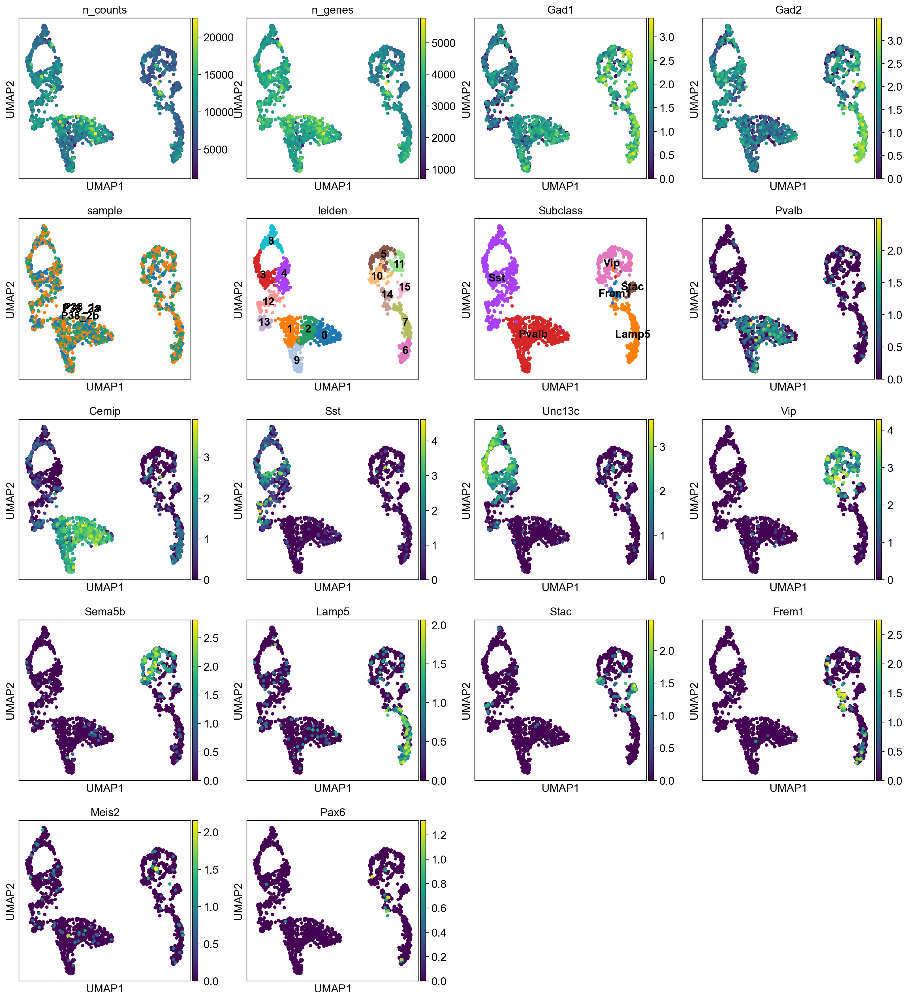

In [48]:
sc.pl.umap(P38_gaba, color=['n_counts', 'n_genes', 'Gad1', 'Gad2', 
                           'sample', 'leiden', 'Subclass', 
                          'Pvalb', 'Cemip', 
                           'Sst', 'Unc13c',
                           'Vip', 'Sema5b', 
                           'Lamp5', 'Stac', 'Frem1', 
                           'Meis2', 'Pax6'], legend_loc='on data')

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


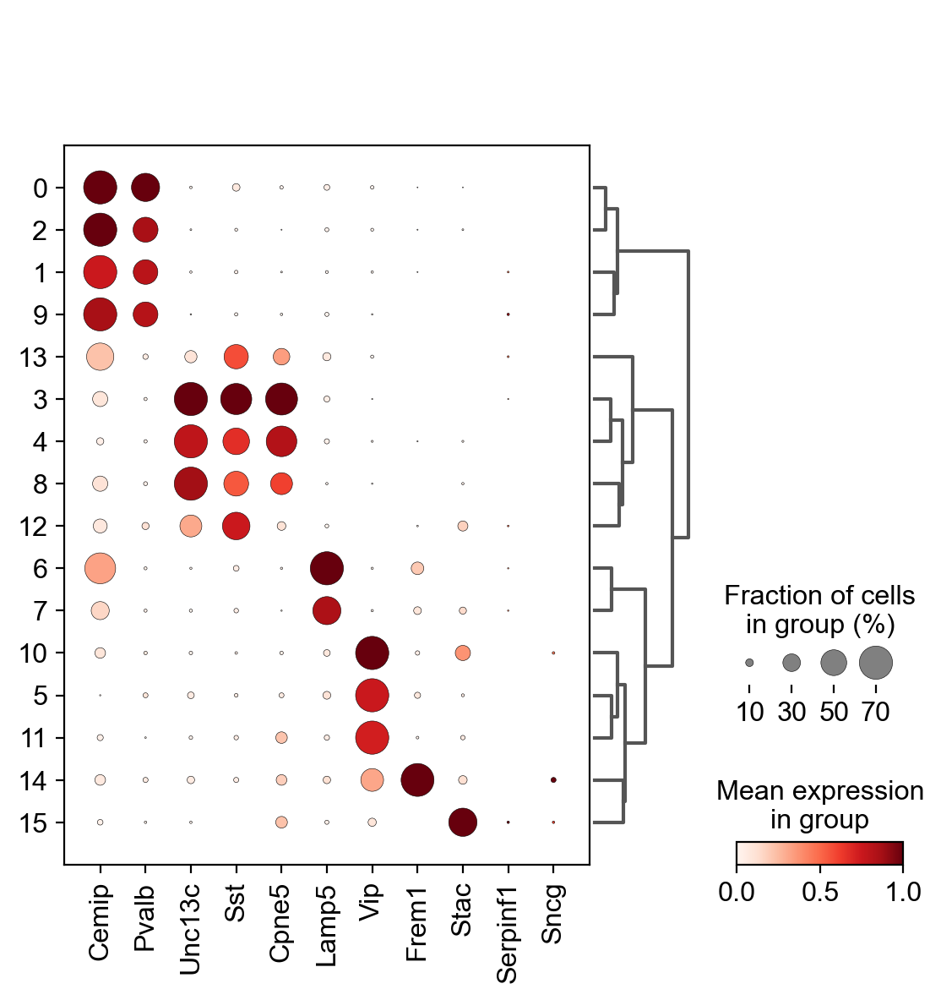

In [50]:
layer_markers = ['Slc17a7',
    'Cux2', 'Ccbe1', 'Mdga1', 
              'Whrn', 'Rorb',
              'Deptor', 
              'Nxph1', 'Tshz2', 'Trhr', 'Slc17a8', 
              'Bcl6', 'Erg', 'Reln', 
              'Cdh9', 'Zfp804b',
              'Foxp2', 'Syt6',
              'Ctgf', 'Inpp4b', 'Svil']

bias_markers = ['Cemip', 'Pvalb',
                'Unc13c', 'Sst',
                  'Cpne5',
                'Lamp5',
                'Vip',
                'Frem1',
                'Stac',
                'Serpinf1', 'Sncg'
                ]

sc.pl.dotplot(P38_gaba, bias_markers, groupby='leiden', 
                   dendrogram=True, standard_scale='var', dot_max=0.7)
#sc.pl.dotplot(P38_gaba, layer_markers, groupby='cluster_name', dendrogram=True)

In [100]:
P38_gaba = sc.read_h5ad(path_out + 'P38_gaba_March.h5ad')
P38_gaba.obs.leiden.values.categories

Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15'],
      dtype='object')

In [101]:
Type = ['Pvalb_B', 'Pvalb_D', 'Pvalb_A', 'Sst_C', 'Sst_A', 'Vip_A', 
        'Lamp5_A', 'Lamp5_B', 'Sst_B', 'Pvalb_C', 'Vip_C', 'Vip_B', 'Sst_E',
       'Sst_D', 'Frem1', 'Stac'] 

P38_gaba.obs['Type'] = P38_gaba.obs['leiden']
a = P38_gaba.obs['Type']
P38_gaba.obs['Type'] = a.cat.rename_categories(Type).values

sc.tl.dendrogram(P38_gaba, groupby='Type', use_rep='X_harmony')

Storing dendrogram info using `.uns["dendrogram_['Type']"]`


/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


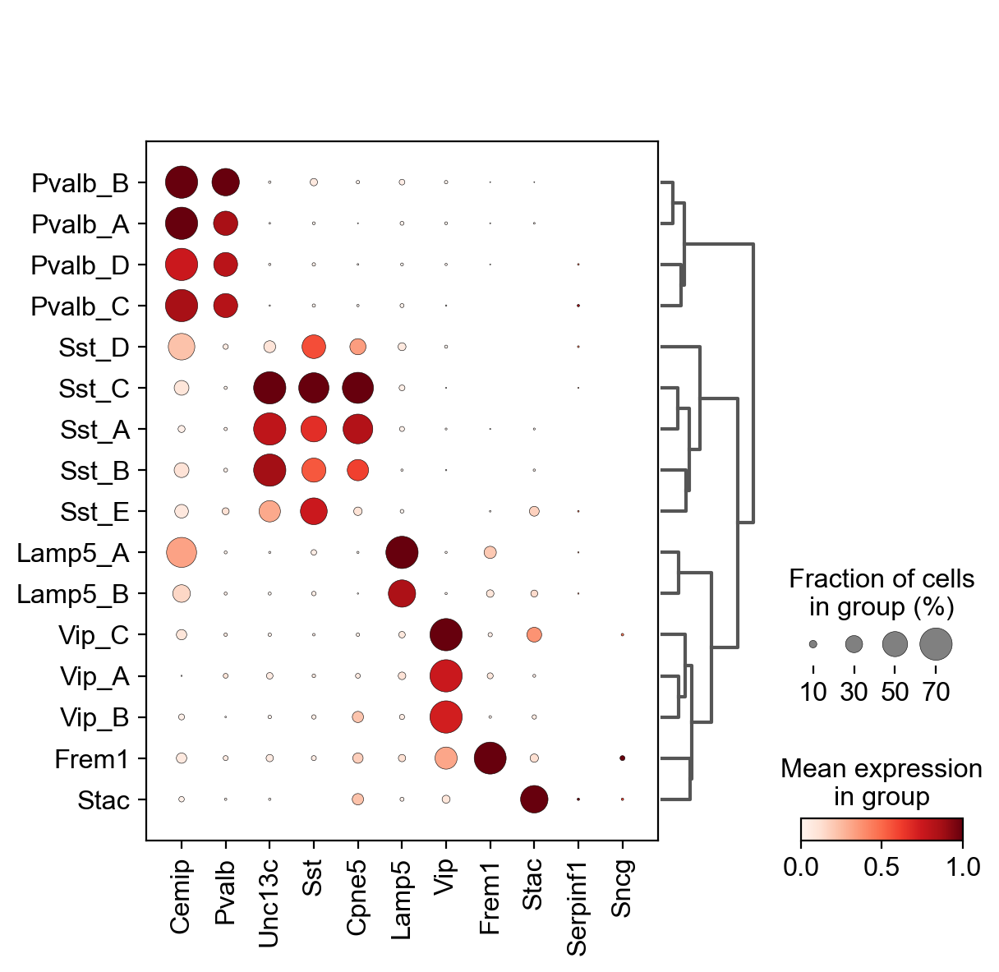

In [102]:
bias_markers = ['Cemip', 'Pvalb',
                'Unc13c', 'Sst',
                  'Cpne5',
                'Lamp5',
                'Vip',
                'Frem1',
                'Stac',
                'Serpinf1', 'Sncg'
                ]

sc.pl.dotplot(P38_gaba, bias_markers, groupby='Type', 
                   dendrogram=True, standard_scale='var', dot_max=0.7)

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


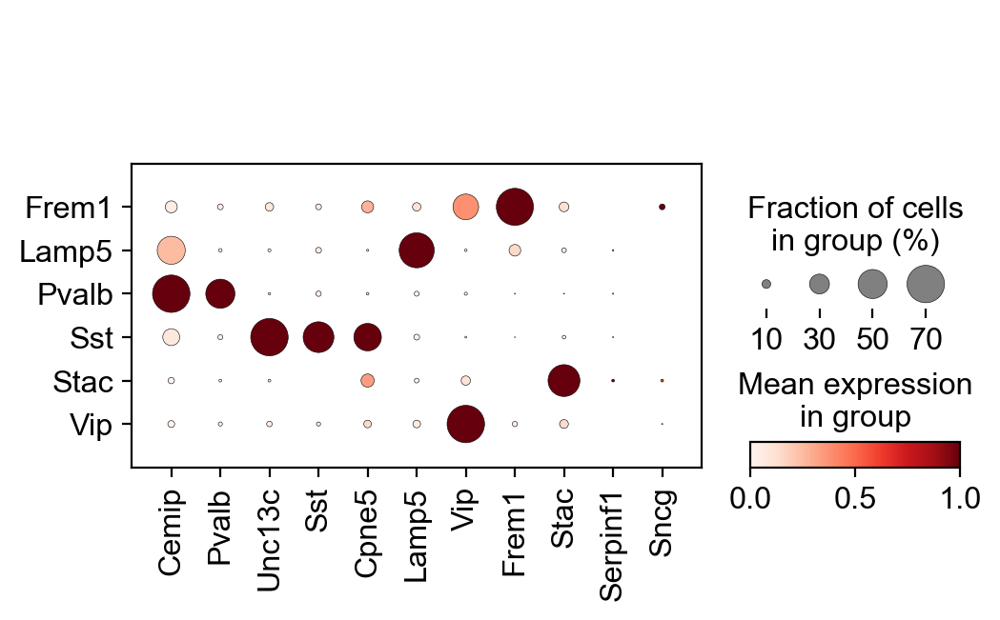

In [109]:
sc.pl.dotplot(P38_gaba, bias_markers, groupby='Subclass',  standard_scale='var', dot_max=0.7)

# Write all ages for MCC

In [111]:
P8_gaba = name_subclass(P8_gaba)
P14_gaba = name_subclass(P14_gaba)
P17_gaba = name_subclass(P17_gaba)
P21_gaba = name_subclass(P21_gaba)
P28_gaba = name_subclass(P28_gaba)
P38_gaba = name_subclass(P38_gaba)

In [112]:

processed_objs = [P8_gaba, P14_gaba, P17_gaba, P21_gaba, P28_gaba, P38_gaba]
ages = ['P8', 'P14', 'P17', 'P21', 'P28', 'P38']

for i in range(len(processed_objs)):
    processed_objs[i].write_h5ad(path_out + ages[i] + '_gaba_March.h5ad')

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
